#PREDICTION DE LA QUALITE D'UNE IMAGE DE FOND D'OEIL

## Bibliotheques


In [ ]:
#bibliothèques
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
import pandas as pd
from PIL import Image
from google.colab.patches import cv2_imshow
from google.colab import drive
from google.colab import files
from sklearn.metrics import roc_auc_score, roc_curve
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC, SVR
from sklearn.metrics import accuracy_score, classification_report, mean_squared_error, r2_score


In [ ]:
#import des fichiers drives (dataset, tableau excel)
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Dataset Augmentation


### Par ajout de bruit


In [ ]:
import cv2
import numpy as np
from PIL import Image
import os

def degrader_image_hardcore(img_path):
    img = cv2.imread(img_path)
    if img is None: return None

    h, w = img.shape[:2]
    k_size = int(min(h, w) * 0.05)
    if k_size % 2 == 0: k_size += 1
    img_flou = cv2.GaussianBlur(img, (k_size, k_size), 0)
    img_petit = cv2.resize(img_flou, (w//4, h//4), interpolation=cv2.INTER_LINEAR)
    img_degrade = cv2.resize(img_petit, (w, h), interpolation=cv2.INTER_NEAREST)

    return img_degrade

In [ ]:
#transformer et sauvegarder dans /Augmentation

source_dir = "/content/drive/MyDrive/PROJET_IMA/Dataset/Image/"
dest_dir = "/content/drive/MyDrive/PROJET_IMA/Dataset/Image/Augmentation/"
os.makedirs(dest_dir, exist_ok=True)

all_images = []
for root, dirs, files in os.walk(source_dir):
    for f in files:
        if f.lower().endswith(".jpg"):
            all_images.append(os.path.join(root, f))

all_images = sorted(all_images)

# On sélectionne les 476 premières
images_to_process = all_images[:476]

print(f"Images trouvées : {len(all_images)}")
print(f"Images traitées : {len(images_to_process)}")


for i, img_path in enumerate(images_to_process, start=1):
    img_np = degrader_image_hardcore(img_path)
    img_rgb = cv2.cvtColor(img_np, cv2.COLOR_BGR2RGB)
    pil_img = Image.fromarray(img_rgb)
    new_name = f"aug{i}.jpg"
    dest_path = os.path.join(dest_dir, new_name)
    pil_img.save(dest_path)

print("Transformation terminée et enregistrée")

Images trouvées : 699
Images traitées : 476
Transformation terminée et enregistrée


### Par rotation

In [ ]:
#FONCTION DE ROTATION :

import cv2

#avec une image en entrée
def rotate_image_im(image, angle):
    (h, w) = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    rotated = cv2.warpAffine(image, M, (w, h))
    return rotated

#avec un path en entrée
def rotate_image(path, angle):
    image = cv2.imread(path)
    (h, w) = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    rotated = cv2.warpAffine(image, M, (w, h))
    return rotated


In [ ]:
#FONCTION EXTRACTION DE FEATURES GLCM (matrice de co-occurence)

import cv2
import numpy as np
from skimage.feature import graycomatrix, graycoprops

#avec une image en entrée
def extract_glcm_features(image_path):

    image = cv2.imread(image_path)
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    distances = [1]
    angles = [0, np.pi/4, np.pi/2, 3*np.pi/4]
    glcm = graycomatrix(gray_image, distances=distances, angles=angles,
                        levels=256, symmetric=True, normed=True)
    contrast = graycoprops(glcm, 'contrast')[0]
    correlation = graycoprops(glcm, 'correlation')[0]
    energy = graycoprops(glcm, 'energy')[0]
    homogeneity = graycoprops(glcm, 'homogeneity')[0]
    features_vector = np.concatenate([contrast, correlation, energy, homogeneity])

    return features_vector

def extract_glcm_features_im(image):
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    distances = [1]
    angles = [0, np.pi/4, np.pi/2, 3*np.pi/4]
    glcm = graycomatrix(gray_image, distances=distances, angles=angles,levels=256, symmetric=True, normed=True)
    contrast = graycoprops(glcm, 'contrast')[0]
    correlation = graycoprops(glcm, 'correlation')[0]
    energy = graycoprops(glcm, 'energy')[0]
    homogeneity = graycoprops(glcm, 'homogeneity')[0]
    features_vector = np.concatenate([contrast, correlation, energy, homogeneity])
    return features_vector


In [ ]:
#TEST DE L'EFFET DE LA ROTATION SUR LES FEATURES

img = cv2.imread("/content/drive/MyDrive/PROJET_IMA/Dataset/ImageClahe/DR/DR-012.jpg")
img15 = rotate_image("/content/drive/MyDrive/PROJET_IMA/Dataset/ImageClahe/DR/DR-012.jpg",15)
img30 = rotate_image("/content/drive/MyDrive/PROJET_IMA/Dataset/ImageClahe/DR/DR-012.jpg",30)
img45 = rotate_image("/content/drive/MyDrive/PROJET_IMA/Dataset/ImageClahe/DR/DR-012.jpg",45)
img90 = rotate_image("/content/drive/MyDrive/PROJET_IMA/Dataset/ImageClahe/DR/DR-012.jpg",90)

print("features extraites de la matrice de co-occurence")
print(extract_glcm_features_im(img))
print(extract_glcm_features_im(img15))
print(extract_glcm_features_im(img30))
print(extract_glcm_features_im(img45))
print(extract_glcm_features_im(img90))

In [ ]:
#NOUVELLE FONCTION D'EXTRACTION DE FEATURES

def extract_features_v2(path):
  image = cv2.imread(path)
  features = np.concatenate([features_statistiques(image), sharpness(image), extract_glcm_features_im(image)])
  return features

print(extract_features_v2("/content/drive/MyDrive/PROJET_IMA/Dataset/ImageClahe/DR/DR-012.jpg"))
print("taille du vecteur de features :",len(extract_features_v2("/content/drive/MyDrive/PROJET_IMA/Dataset/ImageClahe/DR/DR-012.jpg")))


In [ ]:
#CREATION DES NOUVELLES IMAGES TOURNEE DE 15,30,45

if not os.path.exists('/content/drive'):
    drive.mount('/content/drive')
source_dir = "/content/drive/MyDrive/PROJET_IMA/Dataset/ImageClahe"
csv_path = "/content/drive/MyDrive/PROJET_IMA/Dataset/qualite_0.xlsx - annotator 1.csv"

# Liste des configurations
configs_rotation = [
    (15, "Rotation15"),
    (30, "Rotation30"),
    (45, "Rotation45")
]

try:
    df = pd.read_csv(csv_path)
    df.columns = df.columns.str.strip()
    target_images = set(df['ImageID'].dropna().values)
    print(f"Cible : {len(target_images)} images identifiées dans le fichier CSV.")
except FileNotFoundError:
    print(f"ERREUR : Fichier CSV introuvable à : {csv_path}")
    target_images = set()

if target_images:
    for angle, folder_name in configs_rotation:
        current_dest_dir = os.path.join(source_dir, folder_name)
        os.makedirs(current_dest_dir, exist_ok=True)

        print(f"\n--- Traitement pour {angle} degrés -> Dossier : {folder_name} ---")

        count = 0
        for root, dirs, files in os.walk(source_dir):
            if any(cfg[1] in root for cfg in configs_rotation):
                continue

            for file in files:
                if file in target_images:
                    file_path = os.path.join(root, file)
                    img = cv2.imread(file_path)

                    if img is not None:
                        rotated_img = rotate_image(img, angle)
                        save_path = os.path.join(current_dest_dir, file)
                        cv2.imwrite(save_path, rotated_img)
                        count += 1

## Prétraitement des images


Image originale :


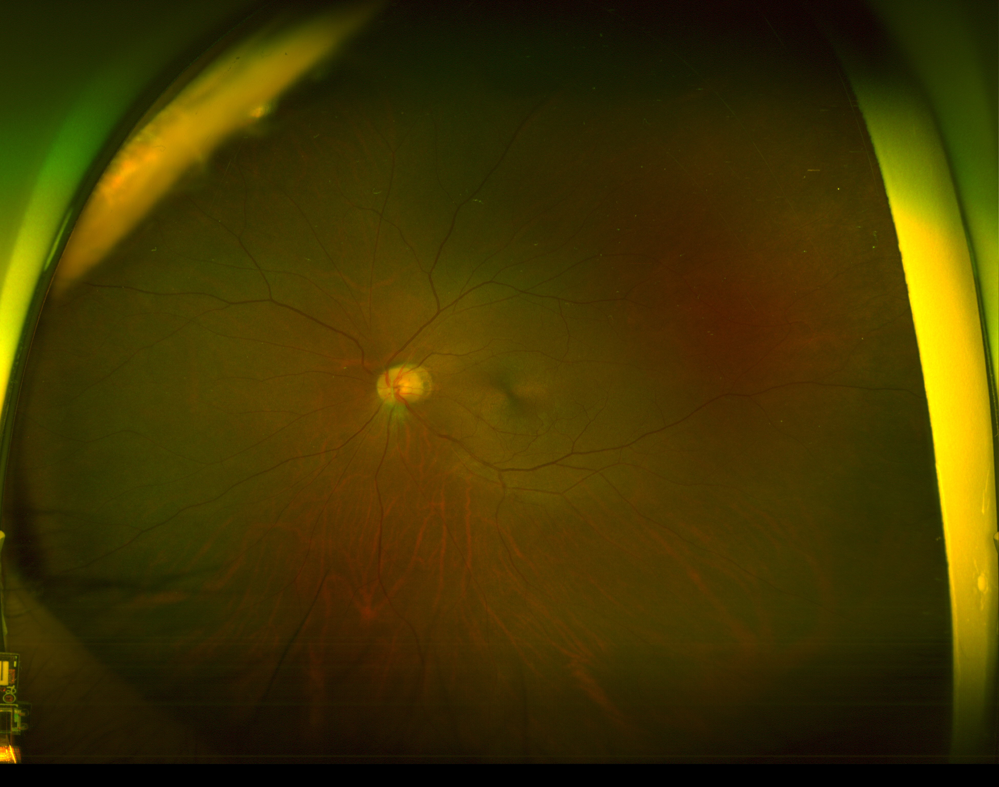

In [ ]:
#chargement de l'image
image_path = "/content/drive/MyDrive/PROJET_IMA/Dataset/Image/AMD/AMD-001.jpg"
image_originale = cv2.imread(image_path)
print("Image originale :")
cv2_imshow(image_originale)

Image redimensionnée :


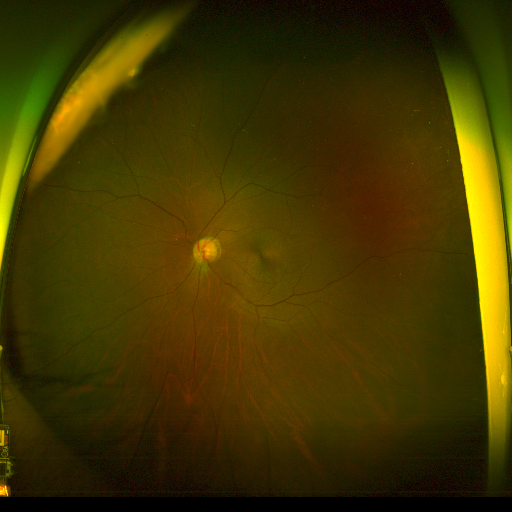

In [ ]:
#redimensionnement de l'image
taille_cible = (512,512)
image_redimensionnée = cv2.resize(image_originale, taille_cible)
print("Image redimensionnée :")
cv2_imshow(image_redimensionnée)

Canal vert isolé :


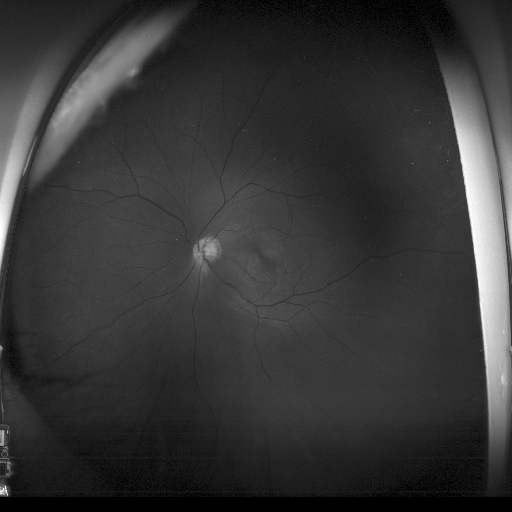

In [ ]:
#isolation du canal vert (garder les informations les plus importantes / réduire le bruit / optimiser le temps de calcul)
canal_vert = image_redimensionnée[:,:,1]

print("Canal vert isolé :")
cv2_imshow(canal_vert)

Avant égalisation :


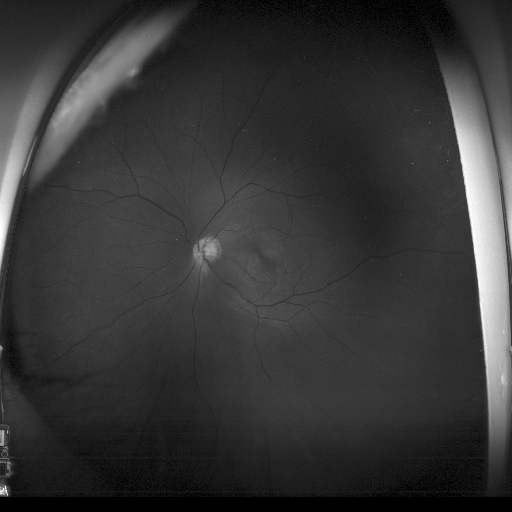

Après égalisation : 


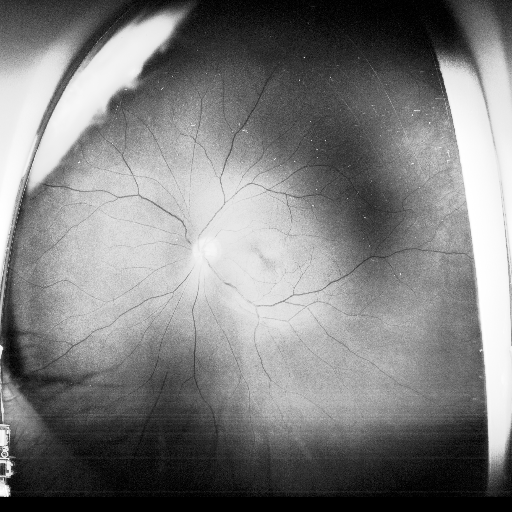

In [ ]:
#amélioration du contraste avec égalisation d'histogramme (faire apparaître des détails cachés)
canal_vert_egalise = cv2.equalizeHist(canal_vert)

print("Avant égalisation :")
cv2_imshow(canal_vert)

print("Après égalisation : ")
cv2_imshow(canal_vert_egalise)

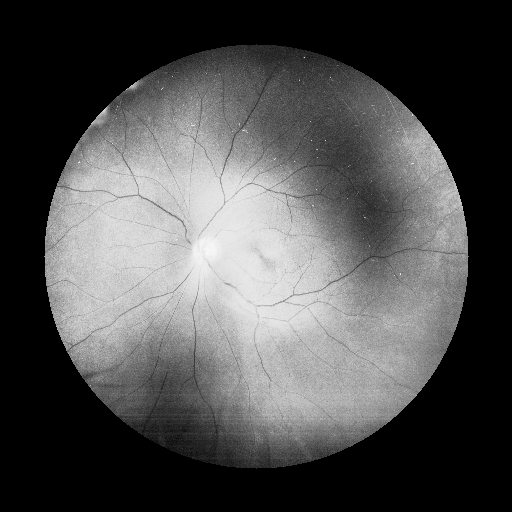

In [ ]:
#Rognage circulaire (garder la rétine - ne pas perdre de l'information avec les coins)

#masque noir
hauteur, largeur = canal_vert_egalise.shape
masque = np.zeros((hauteur,largeur), dtype=np.uint8)

#
centre = (int(largeur/2), int(hauteur/2))
rayon = int(min(hauteur,largeur)/2*0.83) #90%
cv2.circle(masque, centre, rayon, (255,255,255), -1)
image_finale = cv2.bitwise_and(canal_vert_egalise, canal_vert_egalise, mask=masque)
cv2_imshow(image_finale)

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)
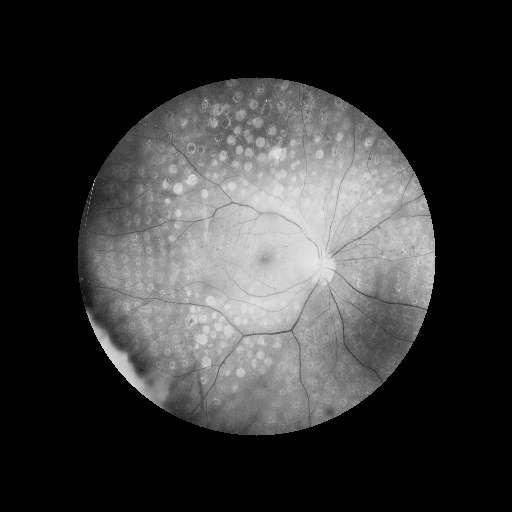

In [ ]:
#PIPELINE FINALE

def pretraitement(image_path):
  image_originale = cv2.imread(image_path)
  taille_cible = (512,512)
  image_redimensionnée = cv2.resize(image_originale, taille_cible)
  canal_vert = image_redimensionnée[:,:,1]
  canal_vert_egalise = cv2.equalizeHist(canal_vert)
  hauteur, largeur = canal_vert_egalise.shape
  masque = np.zeros((hauteur,largeur), dtype=np.uint8)
  centre = (int(largeur/2), int(hauteur/2))
  rayon = int(min(hauteur,largeur)/2*0.70)
  cv2.circle(masque, centre, rayon, (255,255,255), -1)
  image_finale = cv2.bitwise_and(canal_vert_egalise, canal_vert_egalise, mask=masque)
  return image_finale

pretraitement("/content/drive/MyDrive/PROJET_IMA/Dataset/Image/DR/DR-012.jpg")

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)
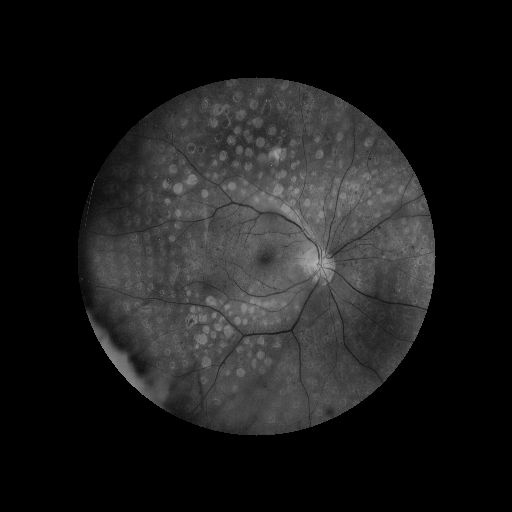

In [ ]:
#AJOUT CLAHE

def pretraitement_clahe(image_path):
  image_originale = cv2.imread(image_path)
  taille_cible = (512,512)
  image_redimensionnée = cv2.resize(image_originale, taille_cible)
  canal_vert = image_redimensionnée[:,:,1]

  #clahe = permet d'égaliser l'histogramme localement grace à des tuiles
  clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8)) #tilegridsize = taille des tuiles pour le calcul local #cliplimit = seuil pour eviter le bruit
  canal_vert_egalise = clahe.apply(canal_vert)

  hauteur, largeur = canal_vert_egalise.shape
  masque = np.zeros((hauteur,largeur), dtype=np.uint8)
  centre = (int(largeur/2), int(hauteur/2))
  rayon = int(min(hauteur,largeur)/2*0.70)
  cv2.circle(masque, centre, rayon, (255,255,255), -1)

  image_finale = cv2.bitwise_and(canal_vert_egalise, canal_vert_egalise, mask=masque)
  return image_finale

pretraitement_clahe("/content/drive/MyDrive/PROJET_IMA/Dataset/Image/DR/DR-012.jpg")

In [ ]:
# Prétraiter toutes les images et les sauvegarder

source_dir = "/content/drive/MyDrive/PROJET_IMA/Dataset/Image"
dest_dir = "/content/drive/MyDrive/PROJET_IMA/Dataset/ImageClahe"
os.makedirs(dest_dir, exist_ok=True)

# Liste des images transformées
images = sorted([f for f in os.listdir(source_dir) if f.lower().endswith(".jpg")])

print(f"Images trouvées : {len(images)}")

for root, dirs, files in os.walk(source_dir):
    relative_path = os.path.relpath(root, source_dir)
    current_dest_dir = os.path.join(dest_dir, relative_path)
    os.makedirs(current_dest_dir, exist_ok=True)

    for filename in sorted(files):

        if filename.lower().endswith(".jpg"):
            img_path = os.path.join(root, filename)
            img_np = pretraitement_clahe(img_path)

            if img_np is not None:
                pil_img = Image.fromarray(img_np)
                dest_path = os.path.join(current_dest_dir, filename)
                pil_img.save(dest_path)

In [ ]:
# Prétraiter les images augmentées

source_dir = "/content/drive/MyDrive/PROJET_IMA/Dataset/Image/Augmentation/"
dest_dir = "/content/drive/MyDrive/PROJET_IMA/Dataset/ImageClahe/Augmentation/"
os.makedirs(dest_dir, exist_ok=True)

# Liste des images transformées
images = sorted([f for f in os.listdir(source_dir) if f.lower().endswith(".jpg")])

for filename in images:
    img_path = os.path.join(source_dir, filename)
    img_np = pretraitement_clahe(img_path)  # numpy GRAY
    pil_img = Image.fromarray(img_np)
    dest_path = os.path.join(dest_dir, filename)
    pil_img.save(dest_path)

## Extraction des Features


In [ ]:
#EXTRACTION FEATURES GLOBALES
#Features Statistiques Globales : moyenne (luminosité globale), ecart-type (contraste global), asymétrie (distribution des pixels penche vers le sombre ou le clair).
from scipy.stats import skew

def features_statistiques(image):
  mean_valeur = np.mean(image)
  std_valeur = np.std(image)
  skew_valeur = skew(image.flatten())
  return [mean_valeur, std_valeur, skew_valeur]

In [ ]:
#EXTRACTION FEATURES ARTICLES
from skimage.filters import frangi

#Features de Netteté et de Flou / sharpness (netteté)
def sharpness(image):
  #calcul de la norme du gradient
  sobel_x = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
  sobel_y = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)
  gradient_magnitude = np.sqrt(sobel_x**2 + sobel_y**2) #norme

  #calcul de pixel >= alpha
  alpha = 2 * np.mean(gradient_magnitude)
  strong_edge_pixels = gradient_magnitude[gradient_magnitude >= alpha]

  #calcul de s1/s2
  total_pixels = image.size
  s1 = strong_edge_pixels.size / total_pixels #densité des contours forts < 1, plus c'est grand mieux c'est (0.05-0.2 est une bonne perf)
  s2 = np.mean(strong_edge_pixels) #force moyenne des contours forts > (200 est une bonne perf)

  return [s1, s2]

def haralick(image):
  #calculer la matrice de co-occurrence (GLCM)
  glcm = graycomatrix(image,
                      distances=[1], # distance entre les pixels
                      angles=[0, np.pi/4, np.pi/2, 3*np.pi/4], # angles
                      levels=256,
                      symmetric=True,
                      normed=True)

  contrast = np.mean(graycoprops(glcm, 'contrast'))
  energy = np.mean(graycoprops(glcm, 'energy'))
  entropy = np.mean(graycoprops(glcm, 'entropy'))

  return [contrast, energy, entropy]


In [ ]:
#fonction extraction de features
import numpy as np
from skimage.feature import graycomatrix, graycoprops

def extract_features(path):
  image = cv2.imread(path,cv2.IMREAD_GRAYSCALE)
  features = features_statistiques(image) + sharpness(image) + haralick(image)
  return features

def extract_features_image(image):
  features = features_statistiques(image) + sharpness(image) + haralick(image)
  return features

print(extract_features("/content/drive/MyDrive/PROJET_IMA/Dataset/ImageP/DR/DR-012.jpg"))

'''
le vecteur de features
0 : mean
1 : std
2 : skew
3 : sharpness s1
4 : sharpness s2
5 : contrast
6 : energy
7 : entropy
'''


[np.float64(56.258216857910156), np.float64(76.14375054960418), np.float64(0.8149265254616064), 0.167694091796875, np.float64(95.02209425353821), np.float64(90.04590246908879), np.float64(0.6007561993551163), np.float64(4.15201761279304)]


'\nle vecteur de features\n0 : mean\n1 : std\n2 : skew\n3 : sharpness s1\n4 : sharpness s2\n5 : contrast\n6 : energy\n7 : entropy\n'

In [ ]:
import skimage.feature

def extract_features_patchs(path, patch_size=(128, 128), seuil_vide=10):

  image_pretraitee = cv2.imread(path,cv2.IMREAD_GRAYSCALE)
  h, w = image_pretraitee.shape
  patch_h, patch_w = patch_size
  features_concatenees = []

  for y in range(0, h, patch_h):
    for x in range(0, w, patch_w):
      patch = image_pretraitee[y:y+patch_h, x:x+patch_w]
      if patch.shape[0] != patch_h or patch.shape[1] != patch_w: #on ignore les patchs si la taille n'est pas parfaite
        continue
      if np.mean(patch) < seuil_vide:
        features_concatenees.append([0]*8)
      else:
        features_concatenees.append(extract_features_image(patch))

  return (np.array(features_concatenees)).flatten()


extract_features_patchs("/content/drive/MyDrive/PROJET_IMA/Dataset/ImageP/DR/DR-012.jpg")

In [ ]:
!pip install git+https://github.com/AIM-Harvard/pyradiomics.git

In [ ]:
import SimpleITK as sitk
from radiomics import featureextractor

def pretraitement_clahe_im_and_mask(image):
  image_originale = image
  taille_cible = (512,512)
  image_redimensionnée = cv2.resize(image_originale, taille_cible)
  canal_vert = image_redimensionnée[:,:,1]
  clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
  canal_vert_egalise = clahe.apply(canal_vert)
  hauteur, largeur = canal_vert_egalise.shape
  masque = np.zeros((hauteur,largeur), dtype=np.uint8)
  centre = (int(largeur/2), int(hauteur/2))
  rayon = int(min(hauteur,largeur)/2*0.70)
  cv2.circle(masque, centre, rayon, (255,255,255), -1)
  image_finale = cv2.bitwise_and(canal_vert_egalise, canal_vert_egalise, mask=masque)
  return image_finale, masque

def extract_pyradiomics_features(path):
  image = cv2.imread(path)
  image_finale, masque = pretraitement_clahe_im_and_mask(image)
  image_sitk = sitk.GetImageFromArray(image_finale.astype(np.float32))
  mask_sitk = sitk.GetImageFromArray((masque > 0).astype(np.uint8))

  # Extraction avec PyRadiomics
  extractor = featureextractor.RadiomicsFeatureExtractor()
  result = extractor.execute(image_sitk, mask_sitk)
  features = {k: v for k, v in result.items() if not k.startswith("diagnostics_")}
  X = np.array(list(features.values()), dtype=np.float32)
  return X

print(extract_pyradiomics_features("/content/drive/MyDrive/PROJET_IMA/Dataset/ImageP/DR/DR-012.jpg"))

## Vecteur de features

In [ ]:
#Extraire les features de chaque image du drive prétraité

images_base_path = '/content/drive/MyDrive/PROJET_IMA/Dataset/ImageP'
excel_path = '/content/drive/MyDrive/PROJET_IMA/Dataset/Individual Quality Assessment.xlsx'

df_labels = pd.read_excel(excel_path)
image_column = "ImageID "
label_column = 'Overall quality'

#dictionnaire avec pour chaque image du dataset, sa qualité associée
label_mapping = pd.Series(df_labels[label_column].values, index=df_labels[image_column]).to_dict()

X_features = []
Y_labels = []

if label_mapping:
    cnt = 0
    for root, dirs, files in os.walk(images_base_path):
        for filename in files:
            print(cnt)
            cnt += 1

            # On définit le label : soit la valeur du dictionnaire, soit 0 par défaut
            if filename in label_mapping:
                label = label_mapping[filename]
            else:
                label = 0  # Si pas dans l'excel, classe 0

            file_path = os.path.join(root, filename)
            features = extract_features(file_path)

            if features is not None:
                X_features.append(features)
                Y_labels.append(label)

    if X_features:
        X = np.array(X_features)
        Y = np.array(Y_labels)
        print("Extraction terminée")

print(f"Taille de X: {len(X_features)}")

In [ ]:
#A UTILISER

images_base_path = '/content/drive/MyDrive/PROJET_IMA/Dataset/ImageClahe'
excel_path = '/content/drive/MyDrive/PROJET_IMA/Dataset/Individual Quality Assessment.xlsx'
output_csv_path = '/content/drive/MyDrive/PROJET_IMA/Dataset/features_labels_CLAHE_sorted_v2_PYRADIO.csv' # Nom du fichier de sortie

df_labels = pd.read_excel(excel_path)
image_column = "ImageID "
label_column = 'Overall quality'

label_mapping = pd.Series(df_labels[label_column].values, index=df_labels[image_column]).to_dict()

X_features_noAug = []
Y_labels_noAug = []
filenames_list = []

print(f"Début de l'extraction depuis {images_base_path}...")

if label_mapping:
    cnt = 0
    for root, dirs, files in os.walk(images_base_path):

        if "Augmentation" in dirs:
            dirs.remove("Augmentation")
        if "Rotation15" in dirs:
            dirs.remove("Rotation15")
        if "Rotation30" in dirs:
            dirs.remove("Rotation30")
        if "Rotation45" in dirs:
            dirs.remove("Rotation45")

        for filename in sorted(files):
            if not filename.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp')):
                continue
            if filename in label_mapping:
                label = label_mapping[filename]
            else:
                label = 0

            file_path = os.path.join(root, filename)
            features = extract_pyradiomics_features(file_path)
            if features is not None:
                X_features_noAug.append(features)
                Y_labels_noAug.append(label)
                filenames_list.append(filename)
                cnt += 1
            print(cnt)

    if X_features_noAug:
        df_final = pd.DataFrame(X_features_noAug)
        df_final['label'] = Y_labels_noAug
        df_final.insert(0, 'filename', filenames_list)

        # 4. Sauvegarder
        df_final.to_csv(output_csv_path, index=False)

In [ ]:
#sauvegarde csv
from google.colab import files

if 'X' in locals() and 'Y' in locals():
    df = pd.DataFrame(X)
    df['label'] = Y  # ajoute la colonne des labels à la fin
    csv_path = '/content/drive/MyDrive/PROJET_IMA/Dataset/features_labels_normal_sorted.csv'
    df.to_csv(csv_path, index=False)
    files.download(csv_path)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
#sauvegarde csv no_aug
from google.colab import files

if 'X' in locals() and 'Y' in locals():
    df = pd.DataFrame(X_noAUG)
    df['label'] = Y_noAUG  # ajoute la colonne des labels à la fin
    csv_path = '/content/drive/MyDrive/PROJET_IMA/Dataset/features_labels_normal_NO_aug.csv'
    df.to_csv(csv_path, index=False)
    files.download(csv_path)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Apprentissage

In [ ]:
#MODELE NORMAL
csv_path = '/content/drive/MyDrive/PROJET_IMA/Dataset/features_labels_CLAHE_sorted_v2_PYRADIO.csv'
df = pd.read_csv(csv_path)
df = df.dropna()

if 'filename' in df.columns:
    df = df.sort_values(by='filename').reset_index(drop=True)

df_save = df

cols_to_drop = ['label']
if 'filename' in df.columns:
    cols_to_drop.append('filename')

X = df.drop(columns=cols_to_drop).values
Y = df['label'].values

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)


#normalisation pour que chaque features soit de même importance
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

#apprentissage
model = SVC(kernel='linear', probability=True, class_weight='balanced', random_state=42) #egalise les classes 0 et 1
model.fit(X_train, Y_train)
Y_pred = model.predict(X_test)

#benchmark
print('predictions = ',Y_pred)
print('valeurs réelles = ', Y_test)
acc = accuracy_score(Y_pred, Y_test)
print(f"précision : {acc:.4f}")
print('auc = ',roc_auc_score(Y_test, Y_pred))
print(classification_report(Y_test, Y_pred))

predictions =  [0 1 1 1 1 1 0 1 1 0 1 0 1 1 1 1 1 1 1 1 1 1 1 0 1 0 1 0 1 1 0 1 1 1 0 0 1
 1 1 1 1 1 1 1 0 1 1 1 1 1 1 0 0 1 1 0 0 1 1 0 1 0 0 1 1 1 1 1 1 1 1 0 0 1
 1 1 1 1 1 1 1 1 1 0 1 0 1 0 1 1 1 0 1 1 1 1 0 0 1 1 0 1 1 1 0 1 1 1 1 1 1
 0 0 1 1 1 1 1 0 0 1 1 1 0 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1]
valeurs réelles =  [0 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0 1 1 0 1 1 1 1 0 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 1 1 0 0 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 0 1 1 0 0 1 1 1 1 1 1
 0 0 1 1 1 0 1 1 1 1 1 1 1 1 0 1 1 1 1 0 1 1 0 1 1 1 1 1 1]
précision : 0.8286
auc =  0.7873651771956857
              precision    recall  f1-score   support

           0       0.47      0.73      0.57        22
           1       0.94      0.85      0.89       118

    accuracy                           0.83       140
   macro avg       0.71      0.79      0.73       140
weighted avg       0.87      0.83      0.84       140



In [ ]:
#MODELE AUGMENTE
from sklearn.metrics import classification_report, accuracy_score

path_orig = '/content/drive/MyDrive/PROJET_IMA/Dataset/features_labels_clahe_patch_NO_aug.csv'
df_orig = pd.read_csv(path_orig)
N = len(df_orig)

path_aug = '/content/drive/MyDrive/PROJET_IMA/Dataset/features_labels_clahe_patch_aug.csv'
df_all = pd.read_csv(path_aug)

df_aug_only = df_all.iloc[N:].reset_index(drop=True)

print(f"Originales : {N}")
print(f"Augmentées récupérées : {len(df_aug_only)}")

X_orig = df_orig.drop(columns=['label']).values
Y_orig = df_orig['label'].values

X_train_ref, X_test_ref, Y_train_ref, Y_test_ref = train_test_split(
    X_orig, Y_orig, test_size=0.2, random_state=42
)

X_aug_all = df_aug_only.drop(columns=['label']).values
Y_aug_all = df_aug_only['label'].values

X_train_final = np.vstack((X_train_ref, X_aug_all))
Y_train_final = np.concatenate((Y_train_ref, Y_aug_all))
scaler = StandardScaler()
X_train_final = scaler.fit_transform(X_train_final)
X_test_ref = scaler.transform(X_test_ref)

model = SVC(kernel='linear', probability=True,class_weight='balanced', random_state=42)
model.fit(X_train_final, Y_train_final)

Y_pred = model.predict(X_test_ref)
print(f"Précision globale : {accuracy_score(Y_test_ref, Y_pred):.4f}")
print(classification_report(Y_test_ref, Y_pred))

Originales : 699
Augmentées récupérées : 476
--- Résumé du Dataset d'entraînement ---
Images originales : 559
Images augmentées ajoutées : 476
Total Train : 1035
Entraînement du modèle en cours...

--- RÉSULTATS SUR LE TEST SET ORIGINAL ---
Précision globale : 0.8714
              precision    recall  f1-score   support

           0       0.47      0.53      0.50        17
           1       0.93      0.92      0.93       123

    accuracy                           0.87       140
   macro avg       0.70      0.72      0.71       140
weighted avg       0.88      0.87      0.87       140

